Обучить СНС с помощью Transfer Learning на датасете Food-101  
Использовать тонкую настройку существующей предобученной модели и методы аугментации данных.  
Библиотеки: [Python, Tensorflow]  

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import tensorflow as tf
import tensorflow_datasets as tfds
import os
import pandas as pd
import time

In [2]:
os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'

In [3]:

def time_matmul(x):
  start = time.time()
  for loop in range(100):
    tf.matmul(x, x)

  result = time.time()-start

  print("100 циклов: {:0.2f}ms".format(1000*result))

for i in range(2):
    # исполнение CPU
    print(" CPU работает:")
    with tf.device("CPU:0"):
      x = tf.random.uniform([1000, 1000])
      assert x.device.endswith("CPU:0")
      time_matmul(x)

    # исполнение на GPU #0 , если доступен
    if tf.config.experimental.list_physical_devices("GPU"):
      print("GPU работает:")
      with tf.device("GPU:0"): # или GPU:1 , для 2х GPU, GPU:2 для 3х  и т.д.
        x = tf.random.uniform([1000, 1000])
        assert x.device.endswith("GPU:0")
        time_matmul(x)

 CPU работает:
100 циклов: 367.29ms
GPU работает:
100 циклов: 552.14ms
 CPU работает:
100 циклов: 337.31ms
GPU работает:
100 циклов: 6.01ms


In [138]:
tfds.disable_progress_bar()
(train_ds, test_ds), ds_info = tfds.load(
    'food101', 
    as_supervised=True,
    with_info=True,
    split=['train[:90%]', 'train[90%:]'],
)

## информация о датасете

In [36]:
num_classes = ds_info.features['label'].num_classes
print(num_classes)

101


In [37]:
len(train_ds),len(test_ds)

(64388, 11362)

In [38]:
get_label_name = ds_info.features['label'].int2str
get_label_name(2)

'baklava'

In [39]:
some_samples = [x for x in iter(train_ds.take(32))]

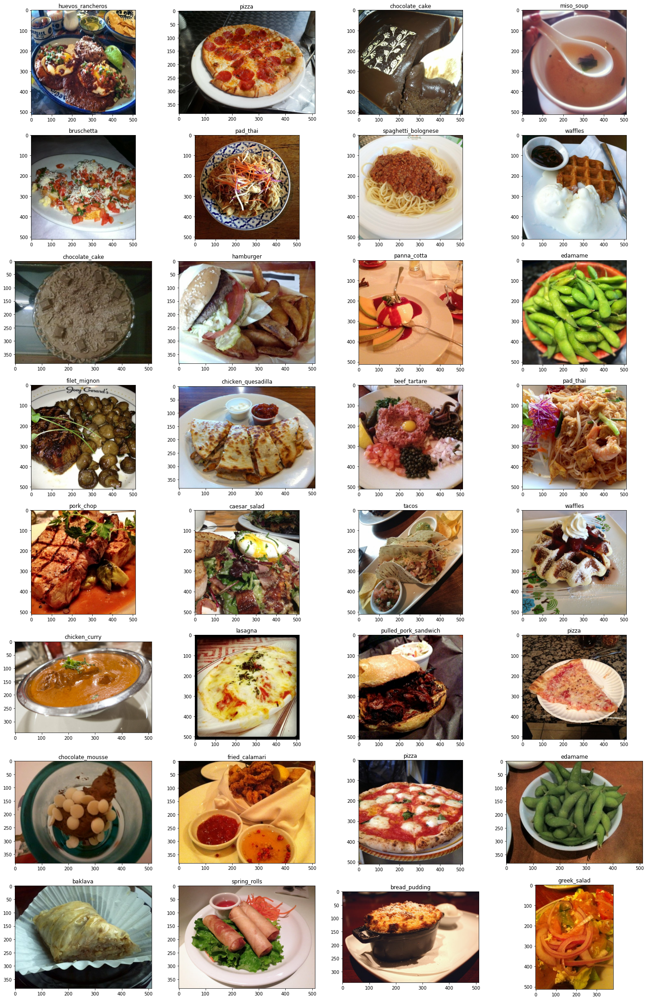

In [40]:
fig = plt.figure(figsize=(25, 40))
for j in range(len(some_samples)):
    ax = fig.add_subplot(8, 4, j+1)
    ax.imshow(some_samples[j][0])
    ax.set_title(get_label_name(some_samples[j][1]))
plt.show()

## Подготовка данных

In [86]:
def res(image, label):
    image = tf.image.resize(image, (224, 224))
    image =tf.cast(image, tf.int32)
    return image, label
    

In [87]:
def brightness_image (image, label):
    seed = tf.random.uniform([2])*1000
    seed = tf.cast(seed, tf.int32)
    image = tf.image.stateless_random_brightness(image, 0.2, seed)
    image = tf.image.resize(image, (224, 224))
    image =tf.cast(image, tf.int32)
    return image, label

In [88]:
def random_flip_up_down (image, label):
    seed = tf.random.uniform([2])*1000
    seed = tf.cast(seed, tf.int32)
    image = tf.image.stateless_random_flip_up_down(image, seed)
    image = tf.image.resize(image, (224, 224))
    image =tf.cast(image, tf.int32)
    return image, label
    

In [89]:
def crop (image, label): 
    seed = tf.random.uniform([2])*1000
    seed = tf.cast(seed, tf.int32)
    image = tf.image.resize(image, (224, 224))
    image = tf.image.stateless_random_crop(
          image, size=[224, 224, 3], seed=seed)
    
    image =tf.cast(image, tf.int32)
    return image , label

In [90]:
def flip(image, label): 
    seed = tf.random.uniform([2])*1000
    seed = tf.cast(seed, tf.int32)
    image = tf.image.stateless_random_flip_left_right(
    image, seed)
    image = tf.image.resize(image, (224, 224))
    image = tf.cast(image, tf.int32)
    return image , label

In [91]:
def test_data_prepare(image, label): 
    image = tf.image.resize(image, (224, 224))
    image =tf.cast(image, tf.int32)
    return image, label
    

In [92]:
def test(patch,model):
    test_img = plt.imread(patch)
    print('Оригинал')
    plt.imshow(test_img)
    plt.show()
    img,_ = test_data_prepare(test_img,0)
    print('Подготовлденное')
    plt.imshow(img)
    plt.show()
    print('предсказания')
    pred = model(img[None, ...], training=False)
    pred_label = pred_label = np.argsort(pred.numpy()[0])[::-1]
    for i in pred_label[:5]:
        print('Prediction: {}'.format(ds_info.features['label'].int2str(i)))

In [139]:
ds_1 = train_ds.map(brightness_image)

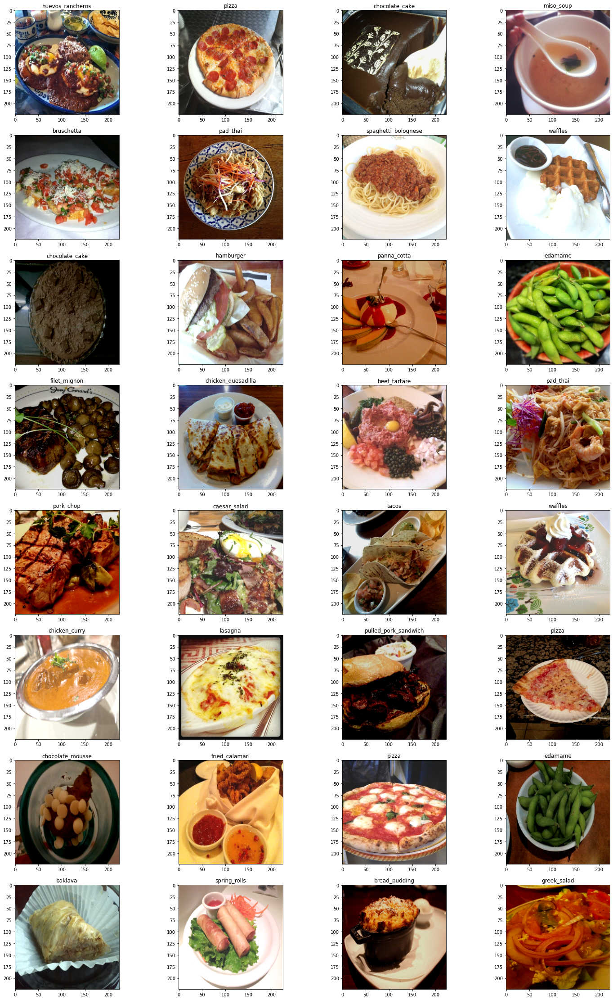

In [113]:
some_samples = [x for x in iter(ds_1.take(32))]
fig = plt.figure(figsize=(25, 40))
for j in range(len(some_samples)):
    ax = fig.add_subplot(8, 4, j+1)
    ax.imshow(some_samples[j][0])
    ax.set_title(get_label_name(some_samples[j][1]))
plt.show()

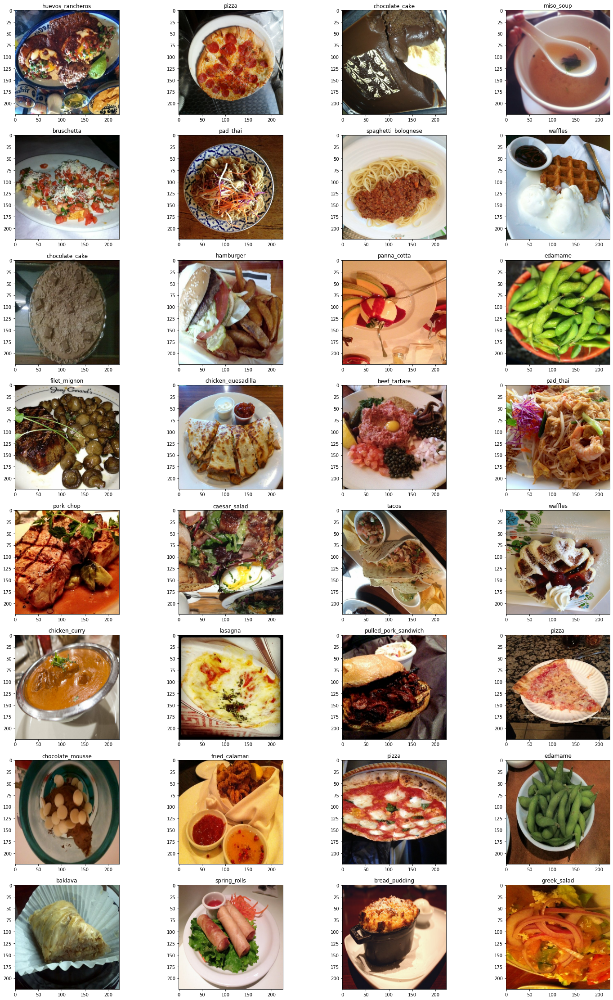

In [140]:
ds_2 = train_ds.map(random_flip_up_down)
some_samples = [x for x in iter(ds_2.take(32))]
fig = plt.figure(figsize=(25, 40))
for j in range(len(some_samples)):
    ax = fig.add_subplot(8, 4, j+1)
    ax.imshow(some_samples[j][0])
    ax.set_title(get_label_name(some_samples[j][1]))
plt.show()

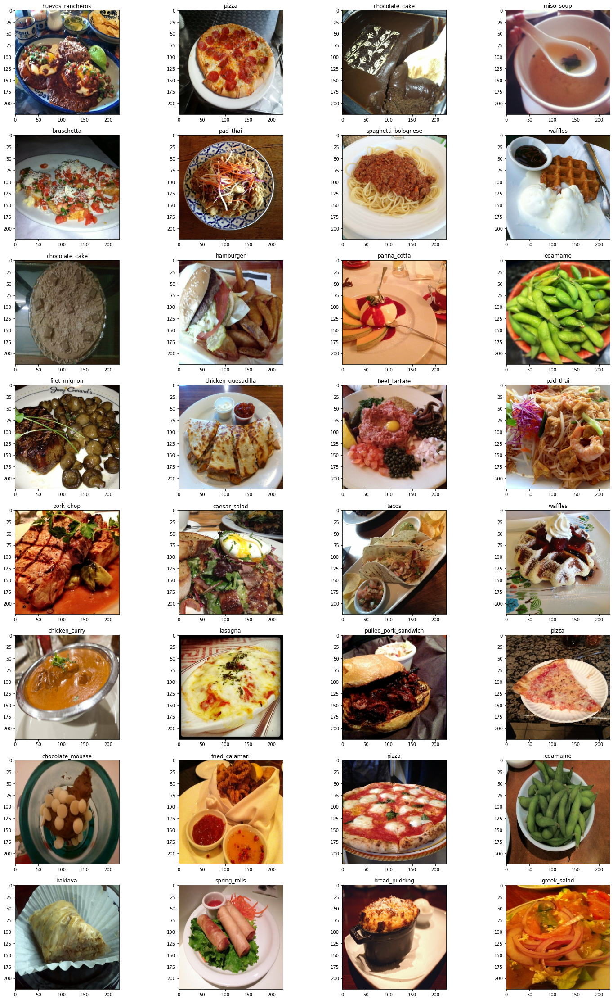

In [141]:
ds_3 = train_ds.map(crop)
some_samples = [x for x in iter(ds_3.take(32))]
fig = plt.figure(figsize=(25, 40))
for j in range(len(some_samples)):
    ax = fig.add_subplot(8, 4, j+1)
    ax.imshow(some_samples[j][0])
    ax.set_title(get_label_name(some_samples[j][1]))
plt.show()

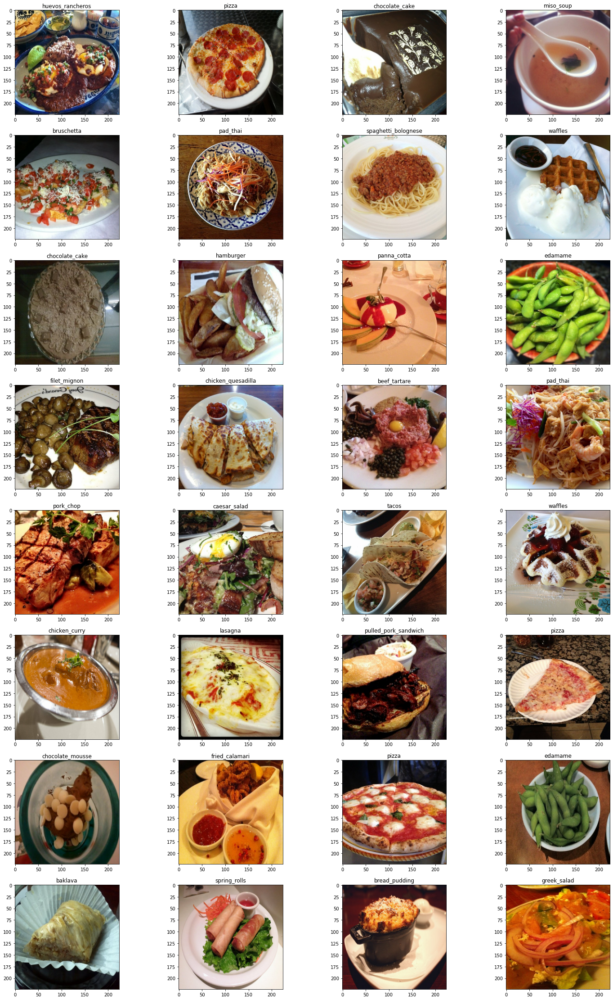

In [142]:
ds_4 = train_ds.map(flip)
some_samples = [x for x in iter(ds_4.take(32))]
fig = plt.figure(figsize=(25, 40))
for j in range(len(some_samples)):
    ax = fig.add_subplot(8, 4, j+1)
    ax.imshow(some_samples[j][0])
    ax.set_title(get_label_name(some_samples[j][1]))
plt.show()

In [143]:
train_ds = train_ds.map(res)

In [144]:
train_ds = train_ds.concatenate(ds_1)
train_ds = train_ds.concatenate(ds_2)
train_ds = train_ds.concatenate(ds_3)
train_ds = train_ds.concatenate(ds_4)

In [145]:
len(train_ds)

340875

In [146]:
# INP_SIZE = 160
# NUM_EPOCHS = 10
BATCH_SIZE = 128
AUTOTUNE = tf.data.AUTOTUNE


train_ds = train_ds.shuffle(buffer_size=10000)
train_ds = train_ds.batch(BATCH_SIZE, drop_remainder=True)
train_ds.prefetch(buffer_size=AUTOTUNE)

test_ds = test_ds.shuffle(buffer_size=5000)
test_ds = test_ds.map(test_data_prepare,num_parallel_calls=AUTOTUNE)
test_ds = test_ds.batch(128, drop_remainder=True)
test_ds.prefetch(buffer_size=AUTOTUNE)


<PrefetchDataset shapes: ((128, 224, 224, 3), (128,)), types: (tf.int32, tf.int64)>

# Подготовка модели CNN

### Обучаем все слои

In [25]:
base_model = tf.keras.applications.MobileNetV3Large(
        input_shape=(224, 224, 3),
        include_top=False,
        weights='imagenet'
    )
base_model.trainable = True 

In [26]:
model = tf.keras.Sequential([
    base_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(101, activation='softmax'),
])


In [27]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
MobilenetV3large (Functional (None, 1, 1, 1280)        4226432   
_________________________________________________________________
global_average_pooling2d_1 ( (None, 1280)              0         
_________________________________________________________________
dense (Dense)                (None, 101)               129381    
Total params: 4,355,813
Trainable params: 4,331,413
Non-trainable params: 24,400
_________________________________________________________________


In [121]:
LEARNING_RATE = 0.00005
optimizer = tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE)
model.compile(optimizer=optimizer,
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])



In [122]:
%%time
history = model.fit(
    train_ds,
    epochs=1,
    validation_data=test_ds)

10652/10652 [==============================] - 2619s 245ms/step - loss: 0.0530 - accuracy: 0.9853 - val_loss: 1.3648 - val_accuracy: 0.7669
Wall time: 43min 38s


In [123]:
%%time
model.evaluate(test_ds)

59/59 [==============================] - 11s 164ms/step - loss: 1.3644 - accuracy: 0.7669
Wall time: 10.6 s


[1.364373803138733, 0.7669491767883301]

Оригинал


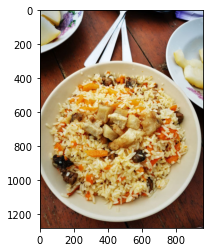

Подготовлденное


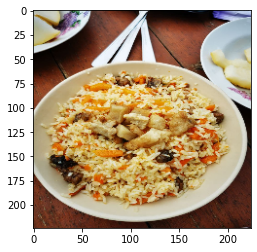

предсказания
Prediction: fried_rice
Prediction: paella
Prediction: frozen_yogurt
Prediction: risotto
Prediction: huevos_rancheros


In [124]:
test('photo_2021-09-08_03-45-04.jpg',model)

Оригинал


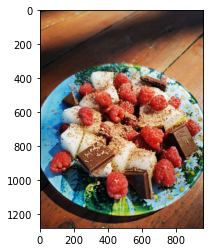

Подготовлденное


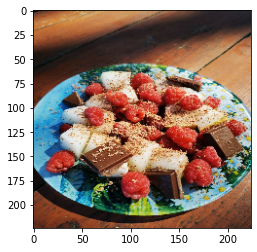

предсказания
Prediction: caesar_salad
Prediction: beignets
Prediction: greek_salad
Prediction: gnocchi
Prediction: panna_cotta


In [125]:
test('1.jpg',model)

Оригинал


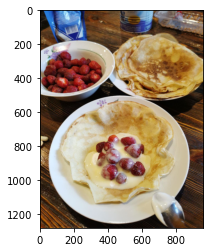

Подготовлденное


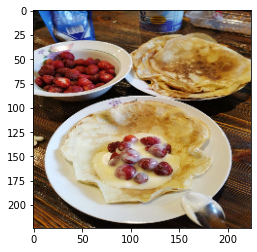

предсказания
Prediction: pancakes
Prediction: strawberry_shortcake
Prediction: huevos_rancheros
Prediction: waffles
Prediction: bread_pudding


In [126]:
test('2.jpg',model)

Оригинал


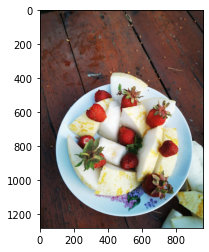

Подготовлденное


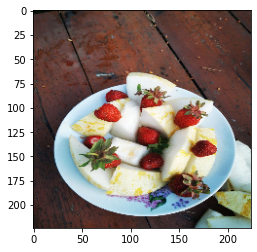

предсказания
Prediction: waffles
Prediction: french_toast
Prediction: strawberry_shortcake
Prediction: pancakes
Prediction: tiramisu


In [127]:
test('3.jpg',model)

Оригинал


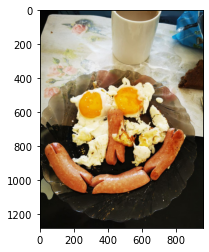

Подготовлденное


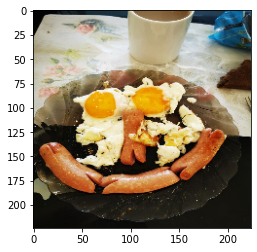

предсказания
Prediction: greek_salad
Prediction: hot_dog
Prediction: fried_rice
Prediction: caesar_salad
Prediction: waffles


In [128]:
test('4.jpg',model)

Оригинал


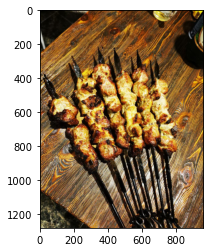

Подготовлденное


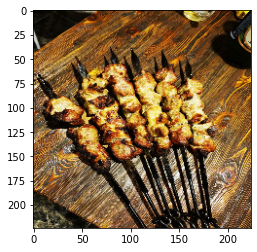

предсказания
Prediction: takoyaki
Prediction: sushi
Prediction: carrot_cake
Prediction: oysters
Prediction: beef_tartare


In [129]:
test('5.jpg',model)

### Обучаем последний слой

In [130]:
base_model = tf.keras.applications.MobileNetV3Large(
        input_shape=(224, 224, 3),
        include_top=False,
        weights='imagenet'
    )
base_model.trainable = False


In [131]:
model = tf.keras.Sequential([
    base_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(101, activation='softmax'),
])


In [132]:
model.compile(optimizer='Adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
MobilenetV3large (Functional (None, 1, 1, 1280)        4226432   
_________________________________________________________________
global_average_pooling2d_3 ( (None, 1280)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 101)               129381    
Total params: 4,355,813
Trainable params: 129,381
Non-trainable params: 4,226,432
_________________________________________________________________


In [147]:
%%time
history = model.fit(
    train_ds,
    epochs=1,
    validation_data=test_ds)

2663/2663 [==============================] - 1208s 450ms/step - loss: 0.7630 - accuracy: 0.7975 - val_loss: 1.4671 - val_accuracy: 0.6365
Wall time: 20min 7s


In [148]:
%%time
model.evaluate(test_ds)

59/59 [==============================] - 12s 170ms/step - loss: 1.4659 - accuracy: 0.6368
Wall time: 11.7 s


[1.4658854007720947, 0.6367849707603455]

Оригинал


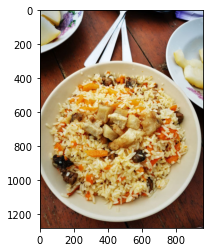

Подготовлденное


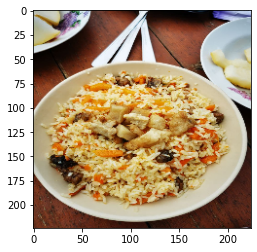

предсказания
Prediction: fried_rice
Prediction: hummus
Prediction: paella
Prediction: gnocchi
Prediction: risotto
Оригинал


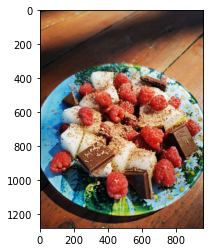

Подготовлденное


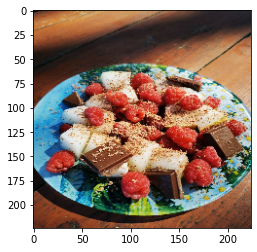

предсказания
Prediction: bruschetta
Prediction: strawberry_shortcake
Prediction: beet_salad
Prediction: takoyaki
Prediction: waffles
Оригинал


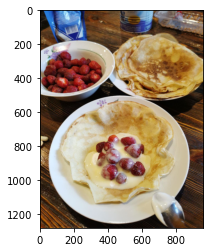

Подготовлденное


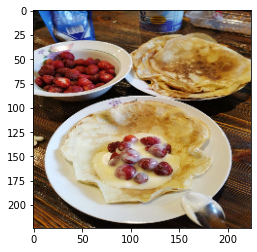

предсказания
Prediction: pancakes
Prediction: hummus
Prediction: huevos_rancheros
Prediction: omelette
Prediction: bread_pudding
Оригинал


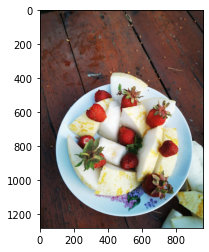

Подготовлденное


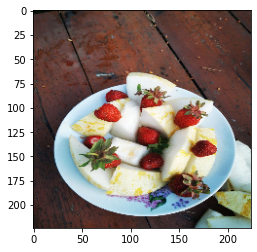

предсказания
Prediction: chocolate_mousse
Prediction: strawberry_shortcake
Prediction: carrot_cake
Prediction: cheesecake
Prediction: waffles
Оригинал


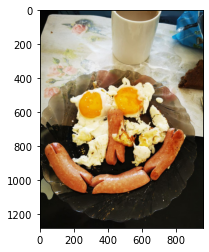

Подготовлденное


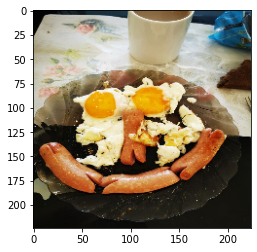

предсказания
Prediction: waffles
Prediction: sushi
Prediction: lobster_roll_sandwich
Prediction: bruschetta
Prediction: huevos_rancheros
Оригинал


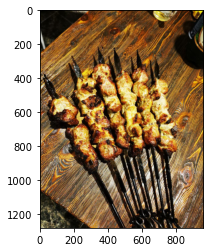

Подготовлденное


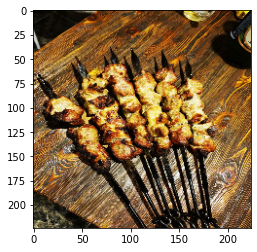

предсказания
Prediction: steak
Prediction: churros
Prediction: garlic_bread
Prediction: bruschetta
Prediction: chocolate_cake


In [149]:
test('photo_2021-09-08_03-45-04.jpg',model)
test('1.jpg',model)
test('2.jpg',model)
test('3.jpg',model)
test('4.jpg',model)
test('5.jpg',model)